# Load the data

The data is stored on the lambda cluster at Argonne National Laboratory at the following paths:
```
/homes/atrifan/second_WE_super_open/spike_WE.pdb
/homes/atrifan/SPIKE_analysis_gb/data/iter_1725_seg_1.dcd
/homes/atrifan/second_WE_super_open/dcds
/homes/atrifan/second_WE_cryoEM_open/dcds
```

In [1]:
ls /homes/atrifan/second_WE_super_open/dcds

traj_1643_533_trace.txt.dcd   traj_1729_1748_trace.txt.dcd
traj_1729_1648_trace.txt.dcd  traj_1729_1751_trace.txt.dcd
traj_1729_1680_trace.txt.dcd  traj_1729_1768_trace.txt.dcd
traj_1729_1683_trace.txt.dcd  traj_1729_1784_trace.txt.dcd
traj_1729_1697_trace.txt.dcd  traj_1729_1794_trace.txt.dcd
traj_1729_1706_trace.txt.dcd  traj_1729_1798_trace.txt.dcd
traj_1729_1708_trace.txt.dcd  traj_1729_1803_trace.txt.dcd
traj_1729_1709_trace.txt.dcd  traj_1729_1816_trace.txt.dcd
traj_1729_1732_trace.txt.dcd


In [2]:
ls /homes/atrifan/second_WE_cryoEM_open/dcds

traj_1012_163_trace.txt.dcd  traj_1576_19_trace.txt.dcd
traj_1576_0_trace.txt.dcd    traj_1576_21_trace.txt.dcd
traj_1576_10_trace.txt.dcd   traj_1576_22_trace.txt.dcd
traj_1576_11_trace.txt.dcd   traj_1576_24_trace.txt.dcd
traj_1576_12_trace.txt.dcd   traj_1576_2_trace.txt.dcd
traj_1576_15_trace.txt.dcd   traj_1576_32_trace.txt.dcd
traj_1576_16_trace.txt.dcd   traj_1576_57_trace.txt.dcd


In [1]:
from pathlib import Path
import MDAnalysis as mda
from typing import List, Tuple
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt

def show_scatter(data: np.ndarray, color: np.ndarray):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.set_facecolor('white')
    ff = ax.scatter(data[:, 0], data[:, 1], data[:, 2], c=color)
    plt.colorbar(ff)
    plt.show()

In [2]:
# Store intermediate results
output_path = Path(".") / "results"
output_path.mkdir(exist_ok=True)

In [3]:
pwd

'/lambda_stor/homes/abrace/src/SpikeProteinAnalysis-GB-2021'

In [4]:
pdb_file = "/homes/atrifan/second_WE_super_open/spike_WE.pdb"
psf_file = "/homes/abrace/src/SpikeProteinAnalysis-GB-2021/we_renumbered.psf"
open_state_pdb_file = "/lambda_stor/homes/abrace/src/SpikeProteinAnalysis-GB-2021/pdb6vsb.pdb"
closed_path = "/homes/atrifan/SPIKE_analysis_gb/data/iter_1725_seg_1.dcd"
open_paths = "/homes/atrifan/second_WE_cryoEM_open/dcds"
super_open_paths = "/homes/atrifan/second_WE_super_open/dcds"

dcd_files = [Path(closed_path)] + list(Path(open_paths).glob("*.dcd")) + list(Path(super_open_paths).glob("*.dcd"))
print("Total DCD files:", len(dcd_files))

Total DCD files: 32


In [5]:
def get_sim_lengths(pdb_file: Path, dcd_files: List[Path]) -> np.ndarray:
    sim_lens = []
    for dcd_file in dcd_files:
        u = mda.Universe(str(pdb_file), str(dcd_file))
        sim_lens.append(len(u.trajectory))
    return np.array(sim_lens)

def get_sim_types(pdb_file: Path, dcd_files: List[Path]) -> np.ndarray:
    """Array with elements 0, 1, 2 based on whether the simulation
    is of a closed, open, or super open spike protein."""
    sim_lens = get_sim_lengths(pdb_file, dcd_files)
    sim_types = []
    for dcd_file, sim_len in zip(dcd_files, sim_lens):
        if dcd_file.name == "iter_1725_seg_1.dcd":
            sim_type = 0
        elif dcd_file.parent.parent.name == "second_WE_cryoEM_open":
            sim_type = 1
        elif dcd_file.parent.parent.name == "second_WE_super_open":
            sim_type = 2
        sim_types.extend([sim_type] * sim_len)
    return np.array(sim_types)

def get_sim_name_and_frame(pdb_file: Path, dcd_files: List[Path]) -> Tuple[List[Path], List[int]]:
    """List of corresponding DCD file and DCD-local frame for each 
    frame in the aggregated trajectories."""
    sim_lens = get_sim_lengths(pdb_file, dcd_files)
    sim_names, sim_frames = [], []
    for dcd_file, sim_len in zip(dcd_files, sim_lens):
        sim_names.extend([dcd_file] * sim_len)
        sim_frames.extend(list(range(sim_len)))
    return sim_names, sim_frames

def write_pdb(pdb_file: Path, dcd_file: Path, frame: int, output_pdb_file: str) -> None:
    u = mda.Universe(str(pdb_file), str(dcd_file))
    atoms = u.select_atoms("all")
    u.trajectory[frame]
    atoms.write(output_pdb_file)

In [6]:
def get_positions(pdb_file: Path, dcd_file: Path, selection: str):
    positions = []
    u = mda.Universe(str(pdb_file), str(dcd_file))
    atoms = u.select_atoms(selection)
    for _ in u.trajectory:
        positions.append(atoms.positions.copy())
    positions = np.transpose(positions, [0, 2, 1])
    return positions

def get_all_positions(pdb_file: Path, dcd_files: List[Path], selection: str):
    positions = [
        get_positions(pdb_file, dcd_file, selection) 
        for dcd_file in tqdm(dcd_files)
    ]        
    return np.concatenate(positions)

In [ ]:
positions = get_all_positions(pdb_file, dcd_files, selection="protein and name CA")

In [22]:
# About 5.3 GB
positions.shape

(130880, 3, 3375)

In [37]:
np.save(output_path / "raw_positions.npy", positions)

# Preprocessing
- The AI method works directly on the raw positions of the carbon alpha atoms.
- We also compute the RMSD to the RBD open state for external validation of the AI method.
- The PDB of the open state has PDB ID: 6VSB and can be downloaded from here: https://www.wwpdb.org/pdb?id=pdb_00006vsb
- Please see https://www.nature.com/articles/s41557-021-00758-3 for more details on the RMSD calculation.

## Compute distance between RBD and central helix
Used for post analysis of AI method

In [37]:
def get_rbd_helix_distances(pdb_file: Path, traj_file: Path):
    u = mda.Universe(str(pdb_file), str(traj_file))
    rbd_selection = "name CA and segid AS1 and ((resid 375:380) or (resid 394:404) or (resid 431:438) or (resid 508:517))"
    spikecore_selection = "name CA and (segid AS2 or segid BS2 or segid CS2) and ((resid 747:784) or (resid 946:967) or (resid 986:1034))"
    rbd_atoms = u.select_atoms(rbd_selection)
    spikecore_atoms = u.select_atoms(spikecore_selection)
    distances = []
    for _ in u.trajectory:
        assert rbd_atoms.positions.shape[1] == 3
        rbd_centroid = np.mean(rbd_atoms.positions, axis=0)
        spikecore_centroid = np.mean(spikecore_atoms.positions, axis=0)
        distance = np.linalg.norm(rbd_centroid - spikecore_centroid)
        distances.append(distance)
    return np.array(distances)

def get_all_rbd_helix_distances(pdb_file: Path, traj_files: List[Path]):
    distances = []
    for traj_file in traj_files:
        distances.append(get_rbd_helix_distances(pdb_file, traj_file))
    return np.concatenate(distances)


In [ ]:
rbd_helix_distances = get_all_rbd_helix_distances(psf_file, dcd_files)

In [50]:
np.save(output_path / "rbd_helix_distances.npy", rbd_helix_distances)

array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

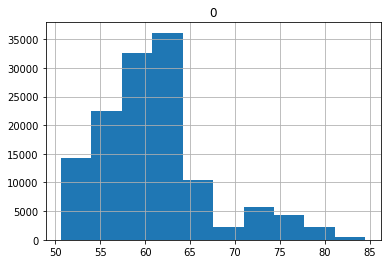

In [39]:
pd.DataFrame(rbd_helix_distances).hist()

## Compute RMSD to the open state structure
Used for post analysis of AI method

In [7]:
from MDAnalysis.analysis import rms, align

def get_open_state_rmsds(
    pdb_file: Path, 
    reference_pdb_file: Path, 
    traj_file: Path, 
    selection: str = "protein and name CA"
):
    sim = mda.Universe(str(pdb_file), str(traj_file))
    ref = mda.Universe(str(reference_pdb_file))
    # Align trajectory to compute accurate RMSD and point cloud
    align.AlignTraj(sim, ref, select=selection, in_memory=True).run()
    # Atom selection for reference
    atoms = sim.select_atoms(selection)
    # Get atomic coordinates of reference atoms
    ref_positions = ref.select_atoms(selection).positions.copy()
    # Compute and store RMSD to reference state
    rmsds = [
        rms.rmsd(atoms.positions, ref_positions, center=True, superposition=True)
        for _ in tqdm(sim.trajectory)
    ]
    return np.array(rmsds)

def get_all_open_state_rmsds(
    pdb_file: Path,
    reference_pdb_file: Path,
    traj_files: List[Path], 
    selection: str = "protein and name CA"
):
    rmsds = []
    for traj_file in traj_files:
        rmsds.append(get_open_state_rmsds(pdb_file, reference_pdb_file, traj_file))
    return np.concatenate(rmsds)

In [8]:
open_state_pdb_file

'/lambda_stor/homes/abrace/src/SpikeProteinAnalysis-GB-2021/pdb6vsb.pdb'

In [12]:
open_state = mda.Universe(open_state_pdb_file)
closed_state = mda.Universe(pdb_file)

In [14]:
print(len(open_state.atoms))
print(len(closed_state.atoms))

22854
63787


In [16]:
print(len(open_state.select_atoms("protein and name CA")))
print(len(closed_state.select_atoms("protein and name CA")))

2905
3375


In [17]:
print(len(open_state.select_atoms("name CA")))
print(len(closed_state.select_atoms("name CA")))

2905
3375


In [18]:
print(len(open_state.select_atoms("protein")))
print(len(closed_state.select_atoms("protein")))

22000
57076


In [9]:
# This currently fails due to the open_state_pdb_file not having enough residues
open_state_rmsds = get_all_open_state_rmsds(pdb_file, open_state_pdb_file, dcd_files)

/lambda_stor/homes/abrace/src/mdlearn/conda-env/lib/python3.7/site-packages/MDAnalysis/coordinates/PDB.py:434: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to zeros.
  warnings.warn("1 A^3 CRYST1 record,"


SelectionError: Reference and trajectory atom selections do not contain the same number of atoms: 
atoms:    N_ref=2905, N_traj=3375
and also not the same number of residues:
residues: N_ref=2905, N_traj=3375

In [ ]:
np.save(output_path / "open_state_rmsds.npy", open_state_rmsds)

In [ ]:
pd.DataFrame(open_state_rmsds).hist()

## First align the positions using kabsch iterative means alignment

In [24]:
from mdlearn.data.preprocess.align import iterative_means_align

In [25]:
itr, avg_coords, e_rmsd, coords = iterative_means_align(
    positions, eps=0.001, max_iter=10, num_workers=30, verbose=True
)

Shape of coords array in iterative_means: (130880, 3, 3375)
Iteration #1 with an error of 0.41062092781066895
Iteration #2 with an error of 0.0036418247036635876
Iteration #3 with an error of 0.0025034004356712103
Iteration #4 with an error of 0.002376271178945899
Iteration #5 with an error of 0.002304015913978219
Iteration #6 with an error of 0.0023154886439442635
Iteration #7 with an error of 0.0025088817346841097
Iteration #8 with an error of 0.002644294174388051
Iteration #9 with an error of 0.0024092942476272583
Iteration #10 with an error of 0.0024390851613134146


In [38]:
np.save(output_path / "e_rmsd.npy", e_rmsd)
np.save(output_path / "coords.npy", coords)

## Then use SD2 to run PCA on the aligned coordinates

In [26]:
from mdlearn.data.preprocess.decorrelation.spatial import SD2

In [27]:
Y, S, B, U = SD2(coords.reshape(-1, 3375*3), m=3375*3, verbose=True)

2nd order Spatial Decorrelation -> Looking for 10125 sources
2nd order Spatial Decorrelation -> Removing the mean value
2nd order Spatial Decorrelation -> Whitening the data


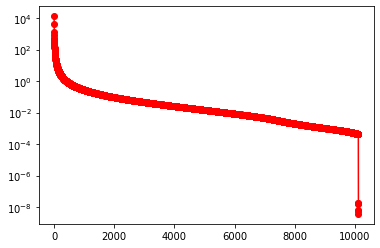

In [32]:
plt.semilogy(S, 'ro-')

In [39]:
np.save(output_path / "Y.npy", Y)
np.save(output_path / "S.npy", S)
np.save(output_path / "B.npy", B)
np.save(output_path / "U.npy", U)

## Then use SD4 to further decorrelate the data

In [40]:
from mdlearn.data.preprocess.decorrelation.spatial import SD4

In [ ]:
# Use the first 60 principal components
W = SD4(Y[0:60,:], m=60, U=U[0:60,:], verbose=False)

In [42]:
np.save(output_path / "W.npy", W)

In [44]:
coordsAll = np.reshape(coords, (len(coords), coords.shape[1] * coords.shape[2])).T
avgCoordsAll = np.mean(coordsAll, 1)
tmpAll = np.reshape(np.tile(avgCoordsAll, coords.shape[0]), (coords.shape[0], coords.shape[1] * coords.shape[2])).T 
caDevsMDall = coordsAll - tmpAll
caDevsMDall.shape

(10125, 130880)

In [45]:
ZPrj4 = W.dot(caDevsMDall)
np.save(output_path / "ZPrj4.npy", ZPrj4)
ZPrj4.shape

(60, 130880)

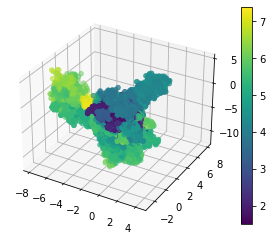

In [47]:
show_scatter(ZPrj4.T[:, :3], e_rmsd[-1])

# Now use an autoencoder to model the nonlinear portions

In [3]:
import pandas as pd
from mdlearn.nn.models.ae.linear import LinearAETrainer

In [4]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [5]:
trainer = LinearAETrainer(
    input_dim=60,
    latent_dim=8,
    hidden_neurons=[32, 16],
    epochs=500,
    verbose=False,
    checkpoint_log_every=50,
    plot_log_every=25,
    plot_n_samples=5000,
    plot_method="raw",
    device="cpu",
)

In [6]:
vars(trainer)

{'seed': 42,
 'scalar_dset_names': [],
 'in_gpu_memory': False,
 'num_data_workers': 0,
 'persistent_workers': False,
 'prefetch_factor': 2,
 'split_pct': 0.8,
 'split_method': 'random',
 'batch_size': 128,
 'shuffle': True,
 'device': device(type='cpu'),
 'epochs': 500,
 'verbose': True,
 'clip_grad_max_norm': 10.0,
 'checkpoint_log_every': 50,
 'plot_log_every': 25,
 'plot_n_samples': 5000,
 'plot_method': 'raw',
 'train_subsample_pct': 1.0,
 'valid_subsample_pct': 1.0,
 'use_wandb': False,
 'optimizer_name': 'RMSprop',
 'optimizer_hparams': {'lr': 0.001, 'weight_decay': 1e-05},
 'scheduler_name': None,
 'scheduler_hparams': {},
 'model': LinearAE(
   (encoder): DenseNet(
     (model): Sequential(
       (0): Linear(in_features=60, out_features=32, bias=True)
       (1): ReLU()
       (2): Linear(in_features=32, out_features=16, bias=True)
       (3): ReLU()
       (4): Linear(in_features=16, out_features=8, bias=True)
     )
   )
   (decoder): DenseNet(
     (model): Sequential(
   

In [ ]:
X = ZPrj4.T
scalars = {"rmsd": e_rmsd[-1]}
np.save(output_path / "X.npy", X)
X.shape

In [7]:
X = np.load(output_path / "X.npy")
scalars = {"rmsd": np.load(output_path / "e_rmsd.npy")[-1]}

In [ ]:
trainer.fit(X, scalars, output_path / "ae-run-1")

<AxesSubplot:>

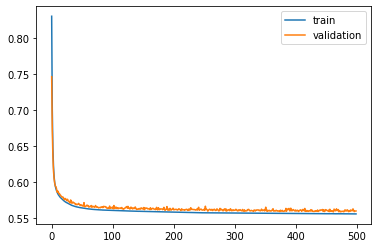

In [66]:
pd.DataFrame(trainer.loss_curve_).plot()

In [67]:
pd.DataFrame(trainer.loss_curve_).to_csv(output_path / "ae-run-1/loss.csv")

# Run inference to generate latent embeddings

In [16]:
X = np.load(output_path / "X.npy")
e_rmsd = np.load(output_path / "e_rmsd.npy")
z, loss = trainer.predict(X, checkpoint=output_path / "ae-run-1/checkpoints/checkpoint-epoch-500.pt")
loss

0.5569014577195048

In [72]:
np.save(output_path / "z.npy", z)
z.shape

(130880, 8)

In [6]:
# Load saved data
X = np.load(output_path / "X.npy")
e_rmsd = np.load(output_path / "e_rmsd.npy")
rbd_helix_distances = np.load(output_path / "rbd_helix_distances.npy")
z = np.load(output_path / "z.npy")

sim_types = get_sim_types(pdb_file, dcd_files)

array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

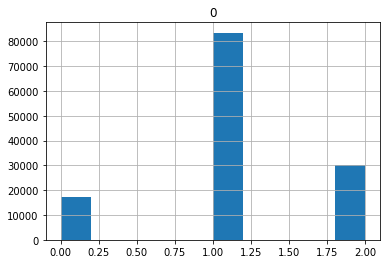

In [40]:
pd.DataFrame(sim_types).hist()

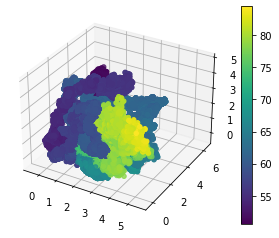

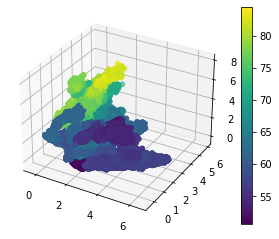

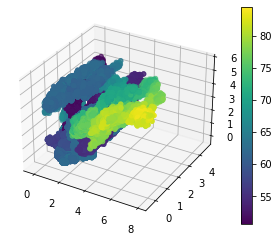

In [41]:
# Latent space painted with the distance between the RBD and central helix
show_scatter(z[:, 0:3], rbd_helix_distances)
show_scatter(z[:, 3:6], rbd_helix_distances)
show_scatter(z[:, 5:8], rbd_helix_distances)

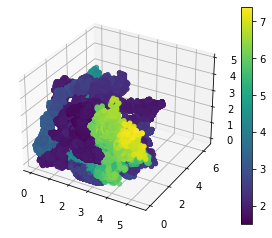

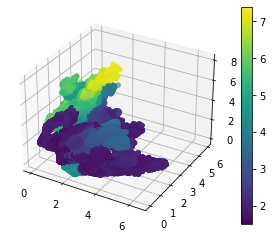

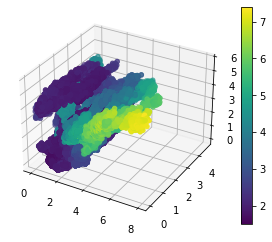

In [70]:
# Latent space painted with the RMSD to the averge structure
show_scatter(z[:, 0:3], e_rmsd[-1])
show_scatter(z[:, 3:6], e_rmsd[-1])
show_scatter(z[:, 5:8], e_rmsd[-1])

In [50]:
sim_lens = get_sim_lengths(pdb_file, dcd_files)
sim_color = np.concatenate([[i] * sim_len for i, sim_len in enumerate(sim_lens)])

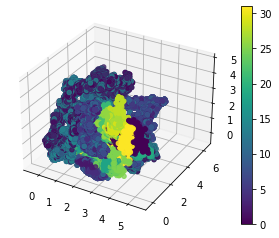

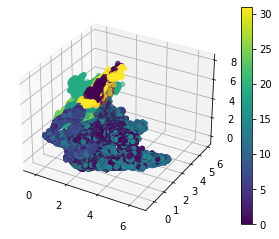

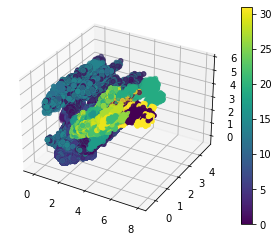

In [53]:
# Paint by simulation (should see overlap)
show_scatter(z[:, 0:3], sim_color)
show_scatter(z[:, 3:6], sim_color)
show_scatter(z[:, 5:8], sim_color)

In [16]:
from mdlearn.utils import plot_scatter

In [ ]:
plot_scatter(z[:,0:3], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "rbd_helix_dist": rbd_helix_distances, "index": np.arange(len(sim_types))}, "rbd_helix_dist")

In [ ]:
plot_scatter(z[:,3:6], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "rbd_helix_dist": rbd_helix_distances, "index": np.arange(len(sim_types))}, "rbd_helix_dist")

In [ ]:
plot_scatter(z[:,5:8], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "rbd_helix_dist": rbd_helix_distances, "index": np.arange(len(sim_types))}, "rbd_helix_dist")

In [ ]:
plot_scatter(z[:,0:3], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "index": np.arange(len(sim_types))}, "rmsd")

In [ ]:
plot_scatter(z[:,3:6], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "index": np.arange(len(sim_types))}, "rmsd")

In [ ]:
plot_scatter(z[:,5:8], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "index": np.arange(len(sim_types))}, "rmsd")

In [ ]:
plot_scatter(z[:,0:3], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "index": np.arange(len(sim_types))}, "sim_types")

In [ ]:
plot_scatter(z[:,3:6], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "index": np.arange(len(sim_types))}, "sim_types")

In [ ]:
plot_scatter(z[:,5:8], {"sim_types": sim_types, "rmsd": e_rmsd[-1], "index": np.arange(len(sim_types))}, "sim_types")

array([<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
       <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>],
      dtype=object)

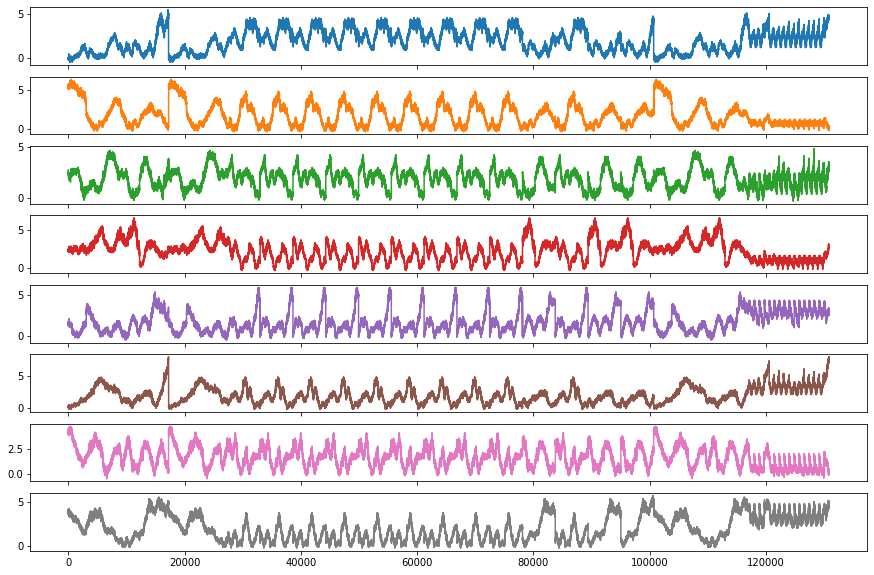

In [51]:
pd.DataFrame(z).plot(subplots=True, legend=False, figsize=(15, 10))

### Visualize with t-SNE

In [24]:
from cuml.manifold import TSNE
# rapidsai only supports 2 dimensions
model = TSNE(n_components=2, method="barnes_hut")
tsne = model.fit_transform(z[::10])

[W] [10:12:50.218724] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


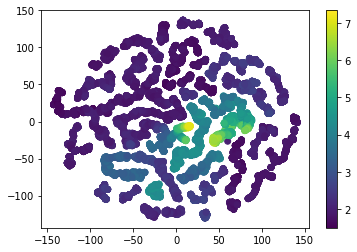

In [25]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_facecolor("white")
ff = ax.scatter(tsne[:, 0], tsne[:, 1], c=e_rmsd[-1][::10])
plt.colorbar(ff)
plt.show()

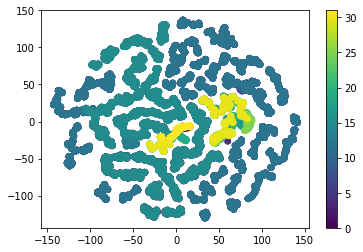

In [35]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_facecolor("white")
ff = ax.scatter(tsne[:, 0], tsne[:, 1], c=sim_color[::10])
plt.colorbar(ff)
plt.show()

# Hand pick outliers from latent space inspection

In [53]:
outlier_indices = [130879, 17242, 130811, 127395, 100799, 94977, 84411, 114233, 104748]
outlier_rmsds = e_rmsd[-1][outlier_indices]
outlier_sim_types = sim_types[outlier_indices]
annotations = [
    "outlier", "similar to next in rmsd and z-space", "similar to previous in rmsd and z-space", 
    "outlier", "outlier", "outlier", "outlier",
    "similar in z-space to next", "similar in z-space to previous",
    "outlier"
]
print(outlier_rmsds)
print(outlier_sim_types)

[7.26661378 7.25401666 7.24326708 6.32179094 4.30703472 2.51990765
 1.71503944 1.9265009  3.31195235]
[2 0 2 2 2 1 1 2 2]


In [54]:
sim_names, sim_frames = get_sim_name_and_frame(pdb_file, dcd_files)

In [71]:
handpicked_outlier_dir = output_path / "handpicked_outliers"
#handpicked_outlier_dir.mkdir()

for index, rmsd in zip(outlier_indices, outlier_rmsds):
    dcd_file = sim_names[index]
    frame = sim_frames[index]
    output_pdb_file = handpicked_outlier_dir / f"{dcd_file.with_suffix('').name}_frame-{frame}_index-{index}_rmsd-{int(round(rmsd, 2) * 100)}.pdb"
    print(output_pdb_file)
    write_pdb(pdb_file, dcd_file, frame, output_pdb_file)

results/handpicked_outliers/traj_1729_1816_trace.txt_frame-859_index-130879_rmsd-727.pdb


/lambda_stor/homes/abrace/src/mdlearn/conda-env/lib/python3.7/site-packages/MDAnalysis/coordinates/PDB.py:864: DeprecationWarning:

Using the last letter of the segid for the chainID is now deprecated and will be changed in 2.0. In 2.0, the chainID attribute will be used if it exists, or a placeholder value.



results/handpicked_outliers/iter_1725_seg_1_frame-17242_index-17242_rmsd-725.pdb
results/handpicked_outliers/traj_1729_1816_trace.txt_frame-791_index-130811_rmsd-724.pdb
results/handpicked_outliers/traj_1729_1784_trace.txt_frame-815_index-127395_rmsd-632.pdb
results/handpicked_outliers/traj_1643_533_trace.txt_frame-109_index-100799_rmsd-430.pdb
results/handpicked_outliers/traj_1576_32_trace.txt_frame-5567_index-94977_rmsd-252.pdb
results/handpicked_outliers/traj_1576_2_trace.txt_frame-641_index-84411_rmsd-172.pdb
results/handpicked_outliers/traj_1643_533_trace.txt_frame-13543_index-114233_rmsd-193.pdb
results/handpicked_outliers/traj_1643_533_trace.txt_frame-4058_index-104748_rmsd-331.pdb


# Cluster data and find outliers 

In [55]:
import random
from collections import Counter

def run_dbscan(data: np.ndarray, eps: float = 1.5, min_samples: int = 10):
    # RAPIDS.ai import as needed
    import cupy as cp
    from cuml import DBSCAN as DBSCAN

    db = DBSCAN(
        eps=eps, 
        min_samples=min_samples,
        max_mbytes_per_batch=1000, # 1GB
    ).fit(cp.asarray(data))
    labels = cp.asnumpy(db.labels_)
    outlier_inds = np.flatnonzero(labels == -1)
    return outlier_inds, labels, db


def dbscan_outlier_search(
    embeddings: np.ndarray,
    num_intrinsic_outliers: int,
    eps: float = 1.5,
    min_samples: int = 10,
    seed: int = 42,
) -> np.ndarray:
    """Find best eps and return corresponding outlier indices."""
    outlier_min = num_intrinsic_outliers
    outlier_max = num_intrinsic_outliers + 200
    attempts = 120
    
    random.seed(seed)

    for i in range(attempts):
        n_outlier = 0
        try:
            print("running_dbscan:", i, "eps:", eps)
            outliers, labels, db = run_dbscan(embeddings, eps, min_samples)
            n_outlier = len(outliers)
        except Exception as e:
            print(e, "\nNo outliers found")

        if n_outlier > outlier_max:
            eps += 0.09 * random.random()
        elif n_outlier < outlier_min:
            eps = max(0.01, eps - 0.09 * random.random())
        else:
            return outliers, labels, db

    raise ValueError("Found no outliers after DBSCAN search.")

In [57]:
outliers, labels, db = dbscan_outlier_search(z, num_intrinsic_outliers=2000)

running_dbscan: 0 eps: 1.5
running_dbscan: 1 eps: 1.4424515881387905
running_dbscan: 2 eps: 1.4402006201687505
running_dbscan: 3 eps: 1.4154479815155299
running_dbscan: 4 eps: 1.3953590150821358
running_dbscan: 5 eps: 1.3290766058073746
running_dbscan: 6 eps: 1.2681736519393125
running_dbscan: 7 eps: 1.1878774908458765
running_dbscan: 8 eps: 1.180052995909229
running_dbscan: 9 eps: 1.1420800321375546
running_dbscan: 10 eps: 1.1393982823881283
running_dbscan: 11 eps: 1.1197208646558041
running_dbscan: 12 eps: 1.0742388887265015
running_dbscan: 13 eps: 1.0718506514549537
running_dbscan: 14 eps: 1.0539552628931554
running_dbscan: 15 eps: 0.9954656634929984
running_dbscan: 16 eps: 0.9464209302387089
running_dbscan: 17 eps: 0.9265812742550462
running_dbscan: 18 eps: 0.8735473627062145
running_dbscan: 19 eps: 0.8006986216052101
running_dbscan: 20 eps: 0.8001137332341847
running_dbscan: 21 eps: 0.727590000569232
running_dbscan: 22 eps: 0.6647574550202915
running_dbscan: 23 eps: 0.634134908533

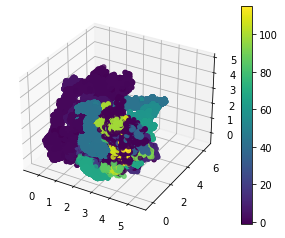

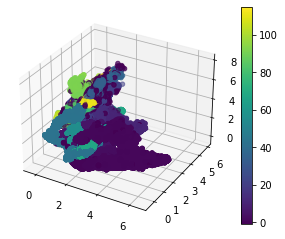

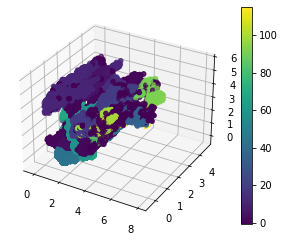

In [58]:
show_scatter(z[:,0:3], labels)
show_scatter(z[:,3:6], labels)
show_scatter(z[:,5:8], labels)

In [59]:
Counter(labels)

Counter({0: 9258,
         -1: 2135,
         1: 34528,
         2: 10,
         3: 2170,
         4: 20,
         5: 9935,
         6: 15,
         7: 10,
         8: 15,
         9: 10,
         10: 25,
         11: 8040,
         12: 10,
         13: 15,
         14: 364,
         15: 54,
         16: 10,
         17: 90,
         18: 26,
         19: 9495,
         20: 21,
         21: 272,
         22: 76,
         23: 154,
         24: 35,
         25: 60,
         26: 29,
         27: 11,
         31: 67,
         28: 12,
         29: 27,
         30: 20,
         32: 21,
         33: 22,
         34: 23,
         35: 36,
         36: 185,
         37: 9,
         38: 30,
         39: 10,
         40: 10,
         41: 10,
         42: 10,
         43: 27810,
         44: 40,
         45: 10,
         46: 10,
         47: 10,
         48: 10,
         49: 10,
         50: 20,
         51: 10,
         52: 10,
         53: 10,
         54: 10,
         55: 10,
         56: 1010,
 

In [60]:
plot_scatter(z[:,5:8], {"rmsd": e_rmsd[-1], "labels": labels}, "labels")

In [62]:
clusters = {label: z[labels == label] for label in np.unique(labels)}

In [63]:
from sklearn.neighbors import LocalOutlierFactor
def run_lof(data: np.ndarray) -> np.ndarray:
    clf = LocalOutlierFactor()
    clf.fit_predict(data)
    lof_scores = clf.negative_outlier_factor_
    return lof_scores

In [64]:
outlier_lof_scores = run_lof(clusters[-1])

In [66]:
lof_df = pd.DataFrame(outlier_lof_scores)

array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

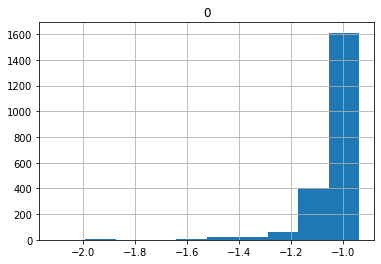

In [67]:
lof_df.hist()

In [69]:
sum(outlier_lof_scores < -1.6)

13

In [71]:
from typing import Optional, Tuple

def show_outlier_scatter(
    data: np.ndarray, 
    color: np.ndarray, 
    outliers: np.ndarray,
    figsize: Optional[Tuple[int, int]] = None,
    label_fontsize: int = 30,
    tick_size: int = 20,
    tick_pad: int = -5,
    cmap: str = "viridis",
    cbar_pad: float = 0.1,
    cbar_fraction: float = 0.04,
    cbar_label: str = "",
    savefig: Optional[str] = None,
    azim: Optional[int] = 0,
    dpi: int = 75
):
    fig = plt.figure(figsize=figsize, facecolor="white")
    ax = fig.add_subplot(111, projection="3d")
    ax.set_facecolor('white')
    
    cnorm = matplotlib.colors.Normalize(
        vmin=np.min(color), vmax=np.max(color)
    )
    scalar_map = matplotlib.cm.ScalarMappable(norm=cnorm, cmap=plt.get_cmap(cmap))
    scalar_map.set_array(color)
    cbar = plt.colorbar(scalar_map, pad=cbar_pad, fraction=cbar_fraction)
    cbar.set_label(label=cbar_label,size=label_fontsize)
    #fig.colorbar(scalar_map, pad=cbar_pad).set_label(label=cbar_label,size=label_fontsize)
    for t in cbar.ax.get_yticklabels():
        t.set_fontsize(tick_size)
    color = scalar_map.to_rgba(color)
    
    
    ax.scatter(data[:, 0], data[:, 1], data[:, 2], c=color)
    #plt.colorbar(ff)
    for i, outlier in enumerate(outliers):
        ax.scatter(
        outlier[0],
        outlier[1],
        outlier[2],
        c="k",
        s=450,
        marker=f"${i + 1}$",
        alpha=1.0,
    )
#     ax.scatter(
#         outliers[:, 0],
#         outliers[:, 1],
#         outliers[:, 2],
#         c="k",
#         s=250,
#         marker="D",
#         alpha=1.0,
#     )
    ax.view_init(elev=20, azim=azim)
    ax.set_xlabel(r"$z_1$", fontsize=label_fontsize)
    ax.set_ylabel(r"$z_2$", fontsize=label_fontsize)
    ax.set_zlabel(r"$z_3$", fontsize=label_fontsize)
    ax.tick_params(axis='both', which='major', labelsize=tick_size, pad=tick_pad)
    ax.tick_params(axis='both', which='minor', labelsize=tick_size, pad=tick_pad)
    plt.tight_layout()
    if savefig is not None:
        plt.savefig(savefig, facecolor=fig.get_facecolor(), transparent=True, dpi=dpi)
    plt.close()
    #plt.show()